Pictures were taken from here https://github.com/Dyakonov/DL/blob/master/2020/DL2020_051unsup_08n.pdf

# Unsupervised altogether

Left part of table - non-probabilistic models

Right part of table - probabilistic (generative) models

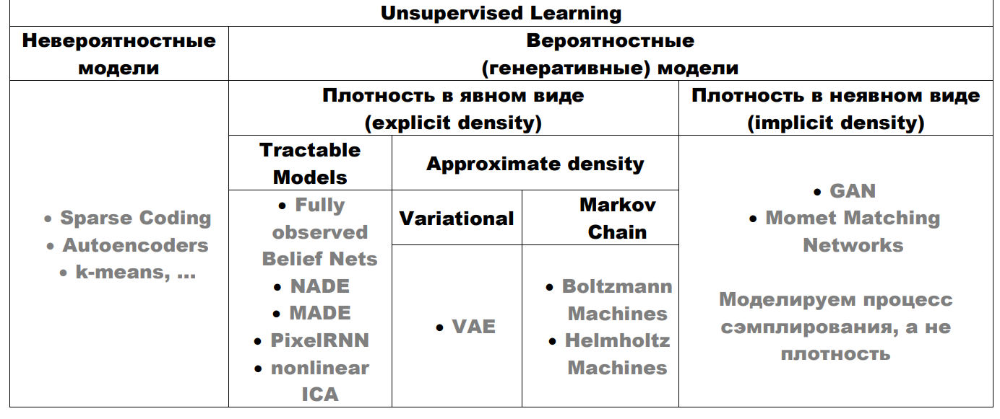

# Non-probabilistic models: Autoencoders

Main idea:
- compress input information to some N-dimensional space, then try to decompress it
- encoder + decoder architechture
- Left - Fully Connected Autoencoder with bottleneck, Right - Convolution Autoencoder

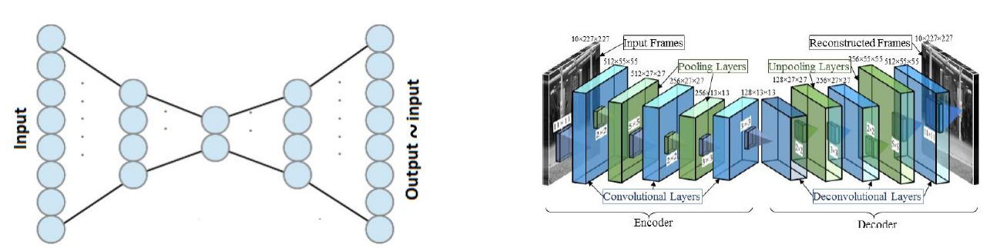

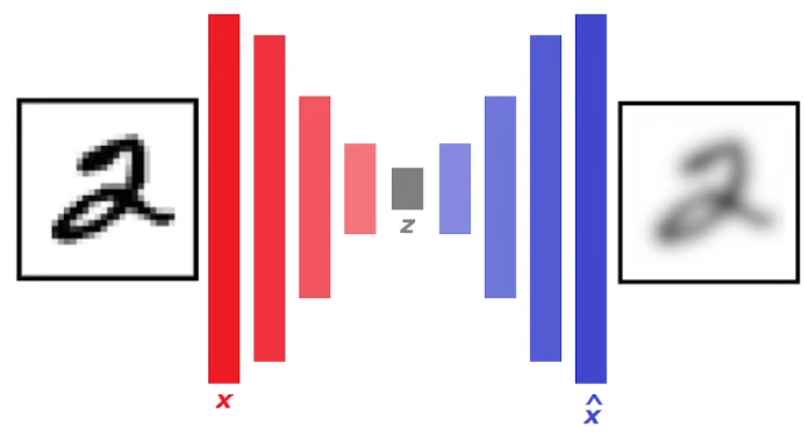

Loss function is MSE, regularization is used. Encoding-decoding can't save-and-restore all data + MSE loss leads to averaging of answer, so output image is blurry.

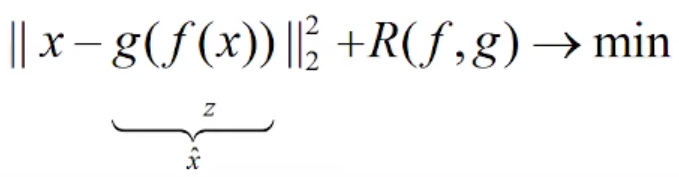

## Autoencoders: why do we need them?

- decreasing of dimensiality, can solve any task in this new reduced space:
    - clusterization
    - anomaly detection (autoencoder is trained to encode usual objects, object-anomaly will be encoded differently)
    - search in reduced space
- feature extraction (for other algorithms)
- pretraining (e.g. train autoencoder and then use encoder part + classification head for image classification)
- special tasks
    - special representations
    - data denoising
    - image inpainting
    
## Autoencoder types: Denoising Autoencoders

- is trained to restore image and delete noise from it
- increase train dataset by adding objects with noise (of different types)
- model learns better quality features

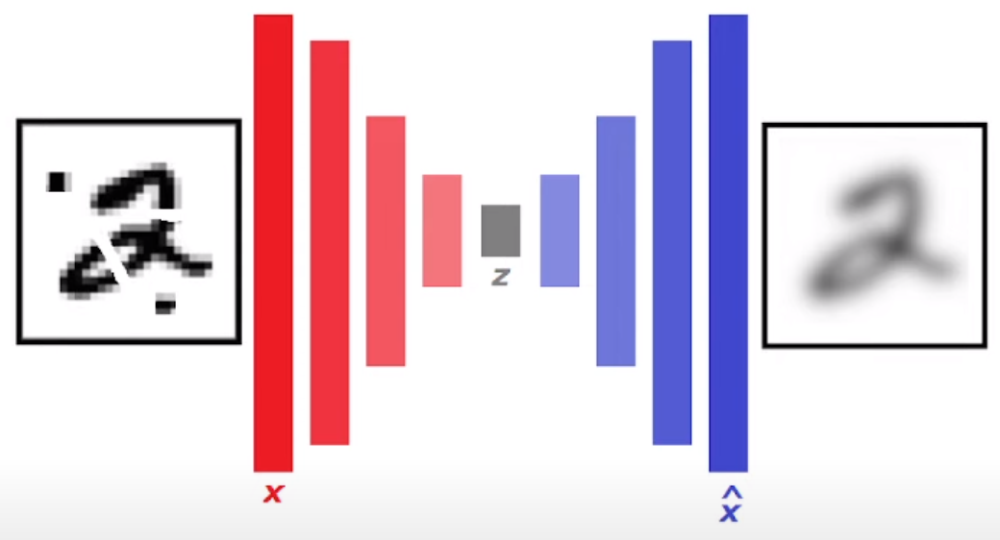

From geometric persprective by adding noise to object we "push" it away from a low-dimensional manifold where most of objects are concentrated. Autoencoder learns to project this object back onto this manifold. So this leads to higher diversity of input objects => model trains better.

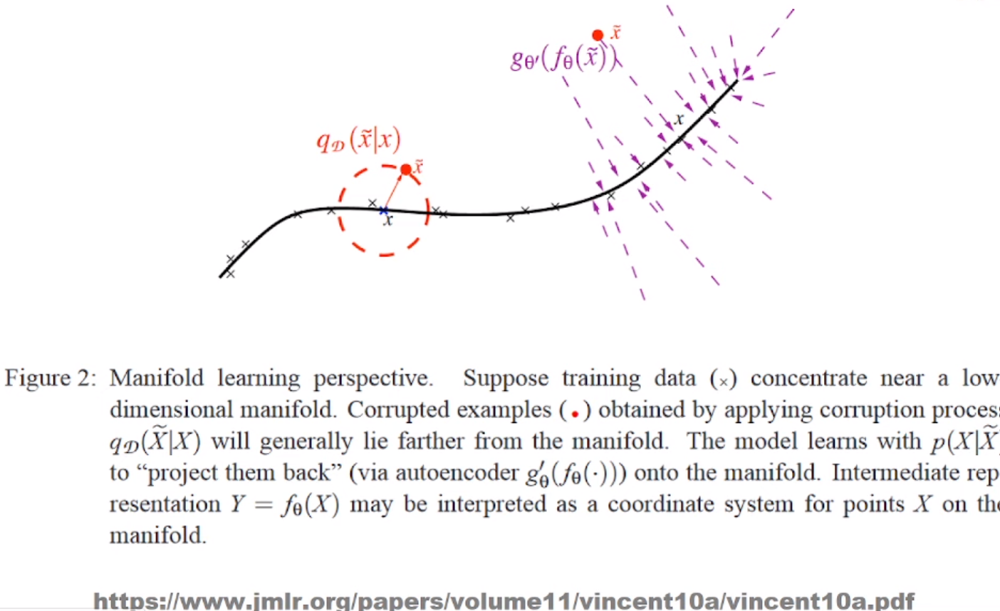
    

## Autoencoder types: Contractive Autoencoder

Main idea: make representation less sensitive to small input data changes => input derivatives must be ~ 0

Then loss function will be:

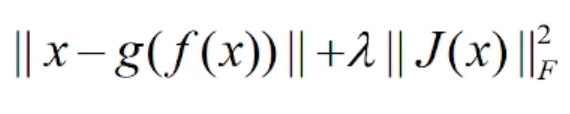

Where J is Jacobian, penalty is square of Frobenius (Euclidian, L2) norm of J.

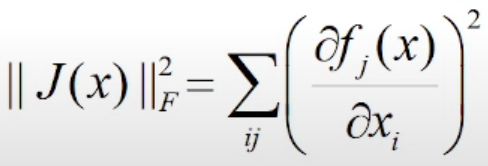

Derivatives are taken in hidden layer f(x)

### Contractive autoencoder: geometric interpretation

We make function to have derivative ~ 0 in the area of point latent representations (latent representation - simplified model of input data). Value of this derivative is huge along manifold and small in directions that are orthogonal to it.

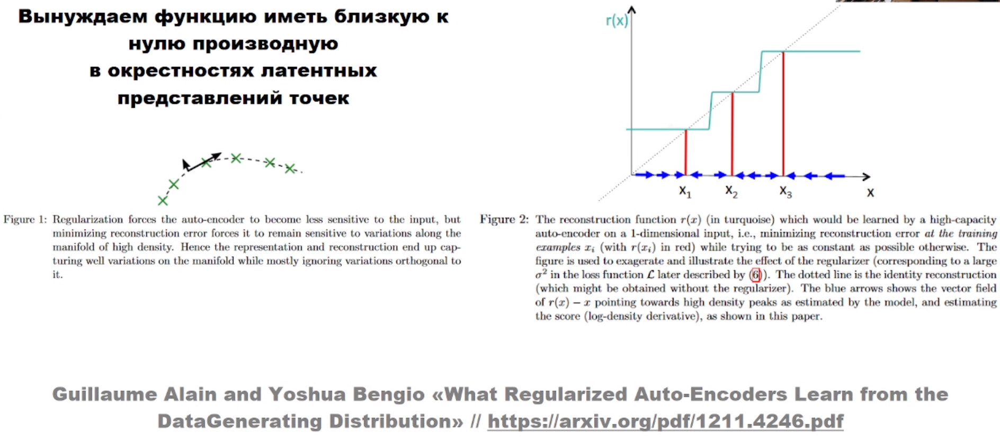

## Autoencoder types: Sparse Coding

Main idea: we want to represent object x<sub>i</sub> from dataset X as sparse linear combination of basises b<sub>j</sub>:

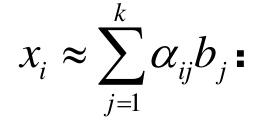

Almost all $\alpha$<sub>ij</sub> must be zero.

So we should use L1 regularization in loss function:

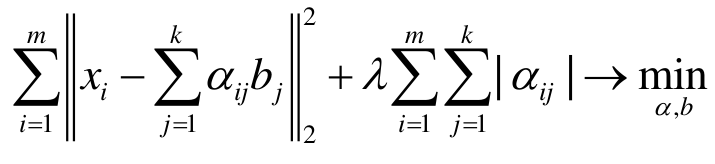

So we:
- encode input image as binary features z
- use L1-regularization for z values
- decode result

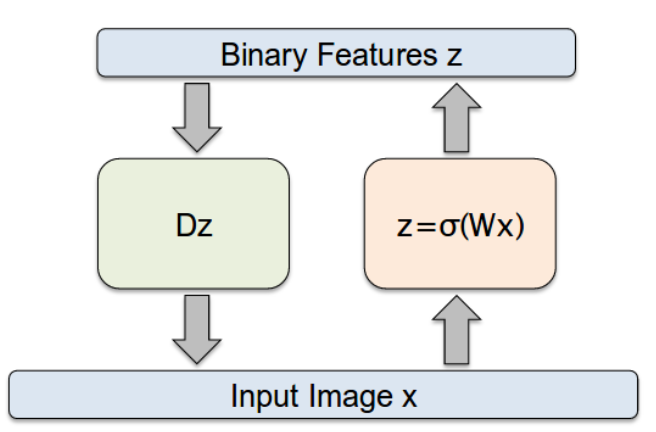

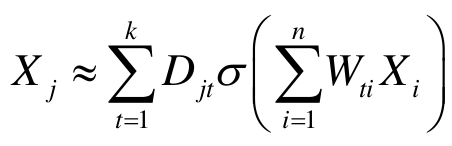

Result loss function:

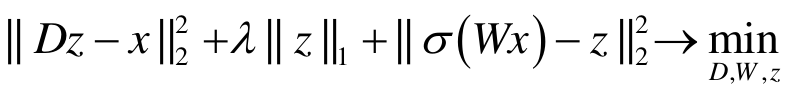

## Autoencoder types: Context encoder

See Context encoder in Self-supervision.ipynb

# Probabilistic (generative) models

# Energy-based models

Main idea: any density can be written as 

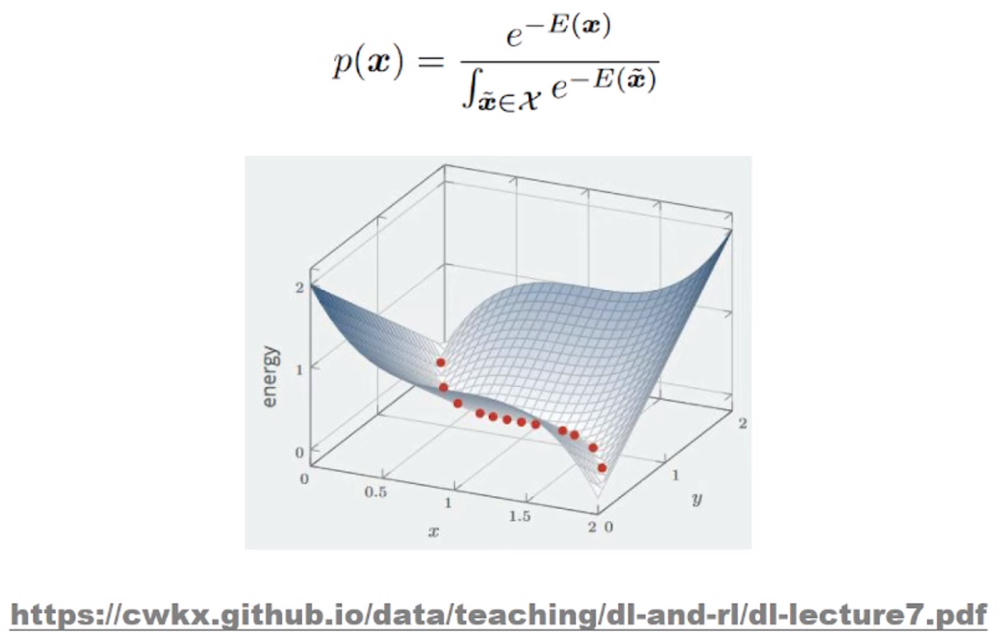

E(x) - energy function of object x. It's small in the area where the probability of object appearance is high and high in opposite case.

## Energy-based models: Boltzmann machine

Boltzmann machine (left) - fully-connected undirected graph of binary neurons, it has visible and hidden neurons.

Restricted Boltzmann machine (RBM) (right) - bipartite undirected graph of binary neurons: visible neurons are independent from each other and activate hidden neurons and opposite.

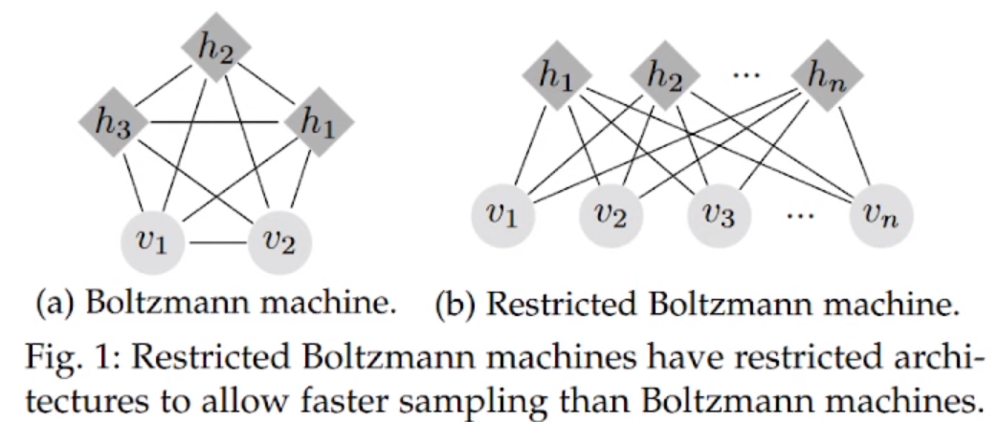

### RBM training

NN energy is

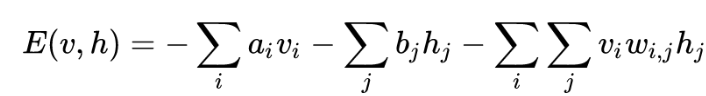

Visible neurons are v<sub>i</sub> = {0, 1} and hidden neurons are v<sub>j</sub> = {0, 1} 

Z(θ) - sum

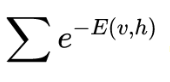

for all possible nets, Z(θ)  is used for normalization

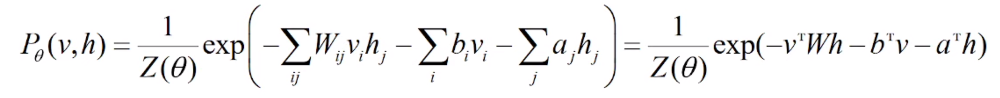

Activation functions

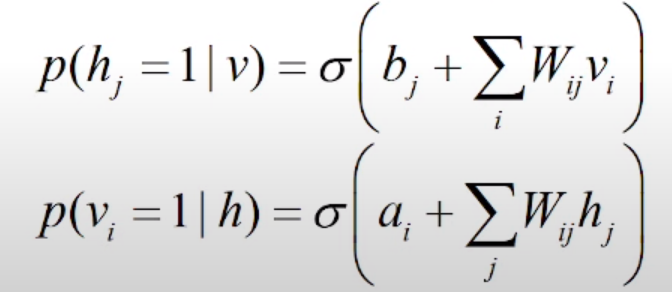

Need to maximize

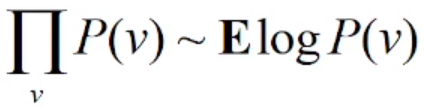


### RBM using

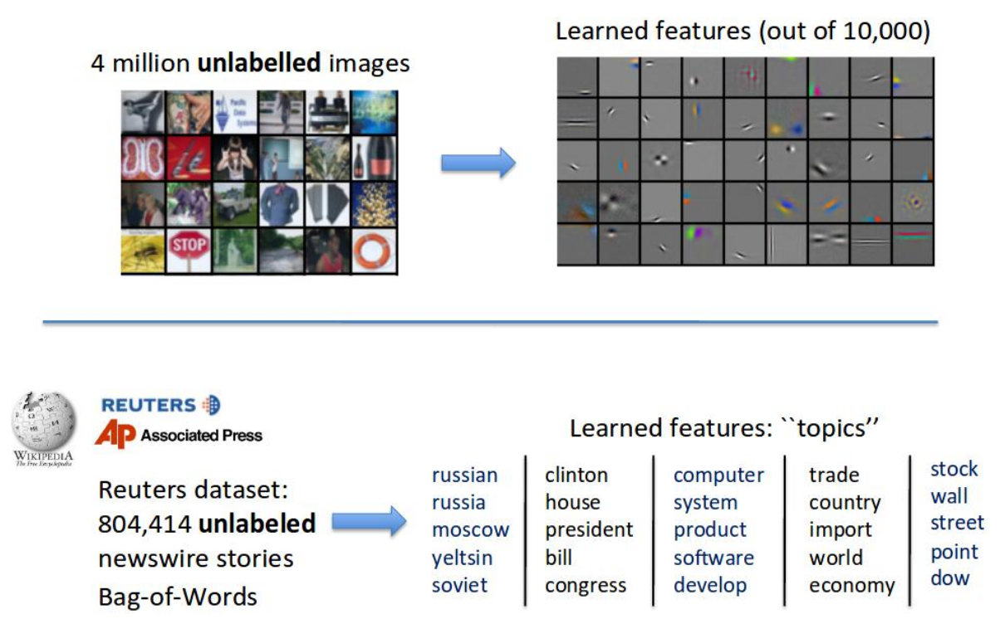

## Self-Organizing Maps (SOM) / Kohonen Maps 

Main idea: project object on map according to it's features.

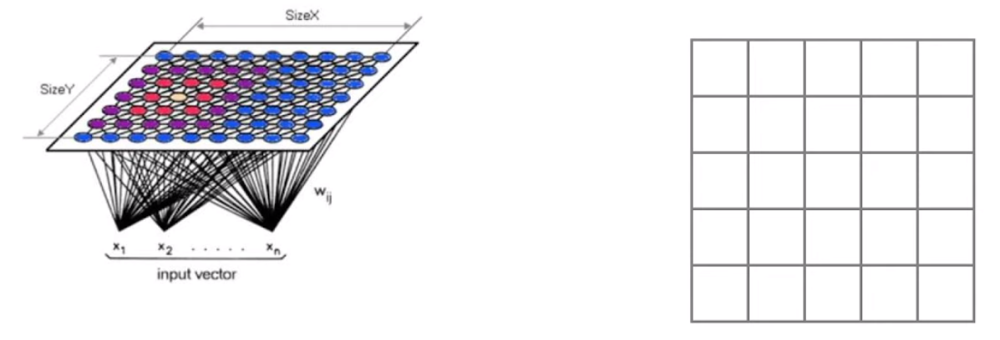

### SOM: training

- randomly initalize weights w<sub>ij</sub>
- send random object x from sample
- find the closest neuron in the map:

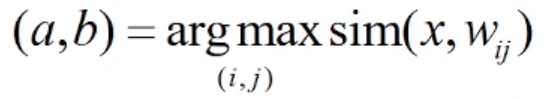

 - sim(x, w<sub>ij</sub>) can be different, for example  sim(x, w<sub>ij</sub>) =  - ||x - w<sub>ij</sub>||
 - update weights:
 
 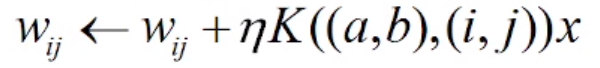
 
 - K((a,b),(i,j)) is some kernel and it can also be different (e.g.  K((a,b),(i,j) = exp(-|a-i| + |b-j|) ) but it most depend on distance from neuron-winner (with a,b coordinates)
 
This weight correction significantly change weights of neuron-winner, less significantly changes weights of neurons-neighbours, etc. The farther neuron is located away from neuron-winner the less significant change of it's weights.

Also SOM:
- builds representation X -> {0, 1, 2, .., k-1}<sup>2</sup> (discrete space)
- solves clusterize task (every map point is a cluster)
- solves task of features representation:
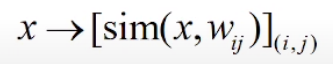
- return metric description (U-matrix):
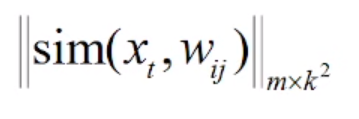

### 1D-SOM vs PCA

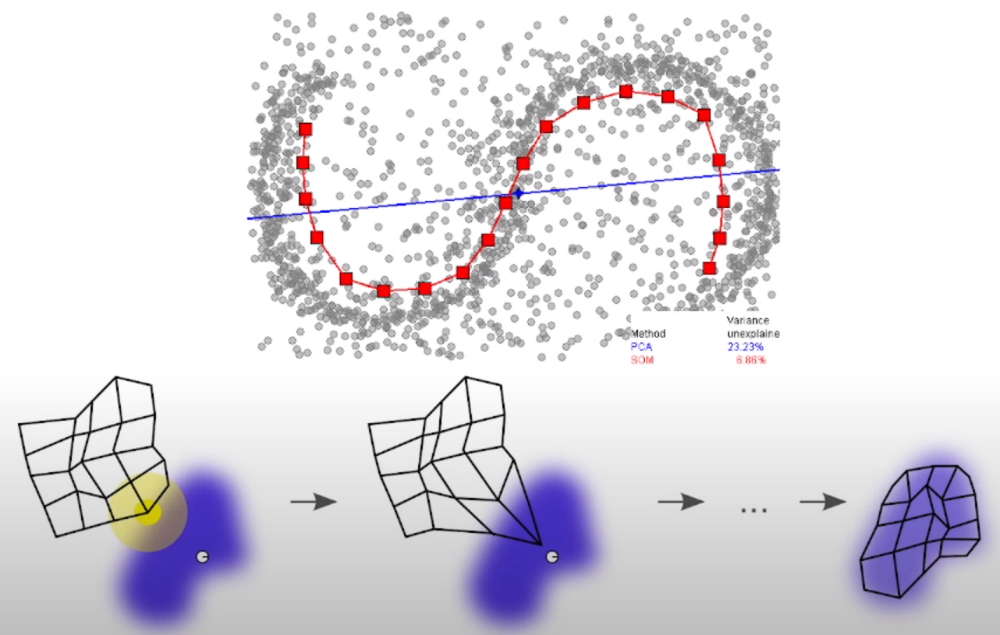


### SOM: advantages

- can watch on the result of SOM work
- gives good enough clusterization

### SOM: disadvantages

- result is frequently random (two launches of SOM on the same data can give completely different maps)
- real object proximity may not correspond with SOM proximity

# Generative models

## Autoregressive models

Use in temporal (time-series) tasks. Predict next data point by previous data points. 

h<sub>i+1</sub> = g(x<sub>i</sub>, h<sub>i</sub>) - hidden state, that was made by model g (it can be DeepNN) using previous hidden state and previous data point.

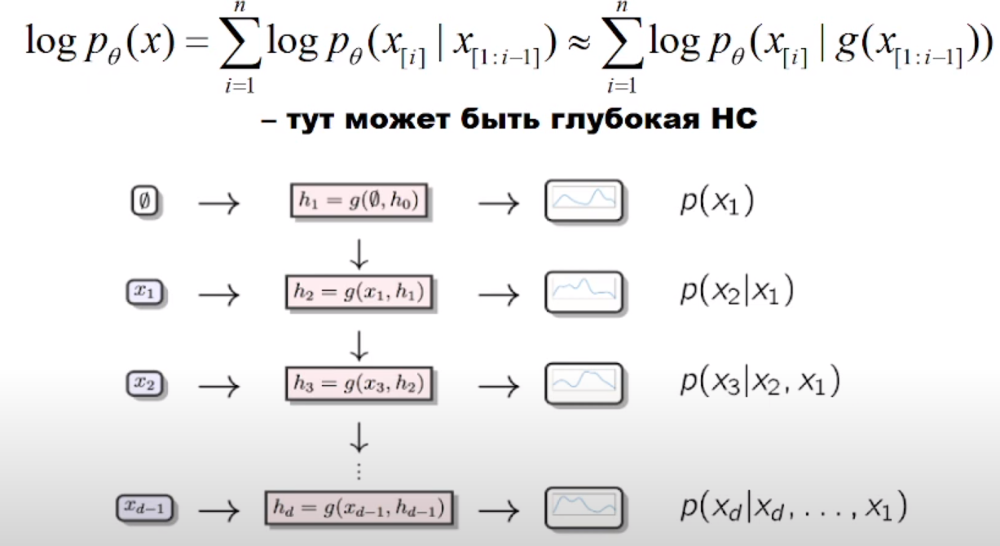

## Autoregressive models: Masked AutoEncoder for Distribution Estimation (MADE)

Main idea: use autoencoder + layer masks to model specific conditional distribution (see picture below)
at the output of the autoencoder.

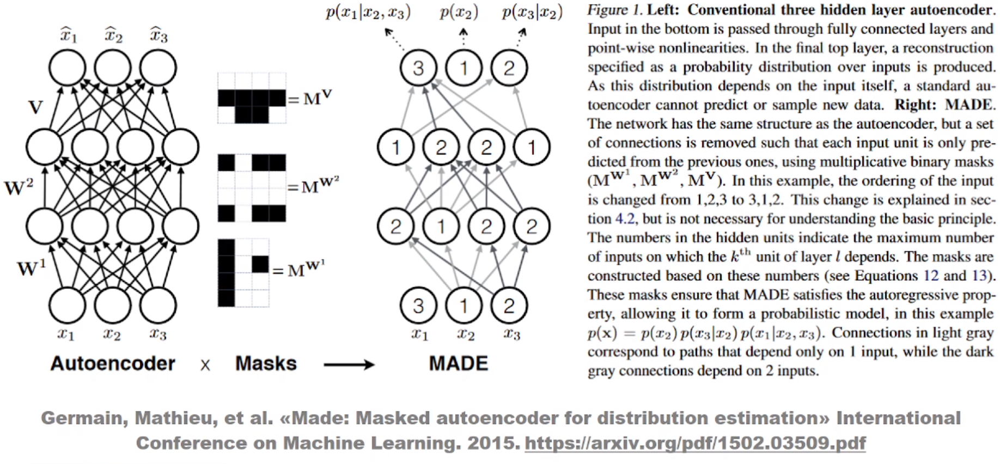

## Autoregressive models: PixelCNN

## PixelCNN: GatedPixelCNN

Use two stacks for pixel generation: horizontal and vertical. Horizontal stack uses all previous pixels in the row to predict the next pixel. Vertical stack uses all previous rows.

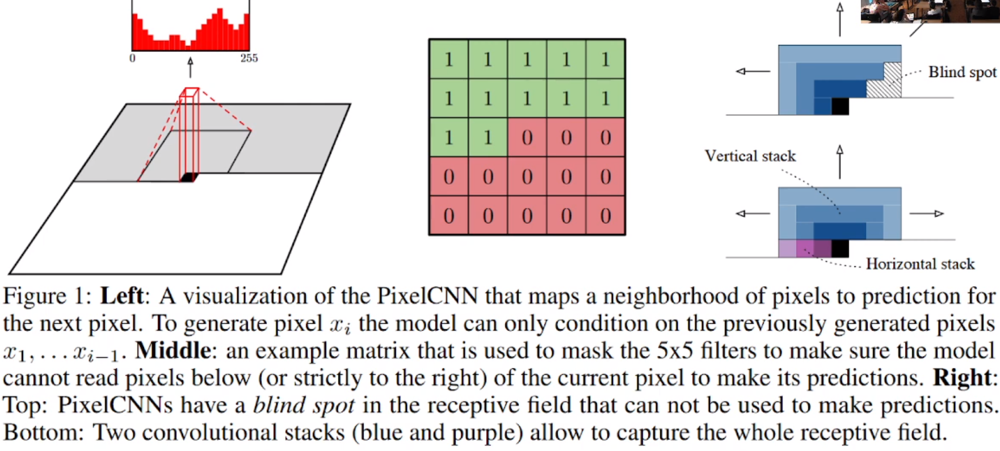

### GatedPixelCNN: architechture

Sign * means convolution and elementwise multiplication

Vertical stack (left) doesn't have residual connection, horizontal stack - has. It is done like this because NN works better.

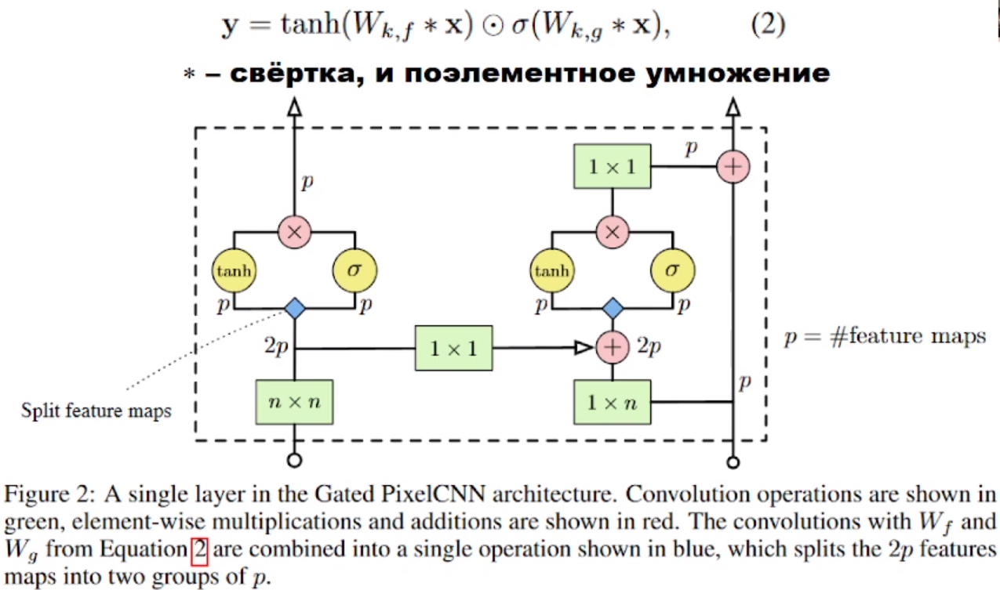

### PixelCNN vs Row LSTM vs Diagonal BiLSTM

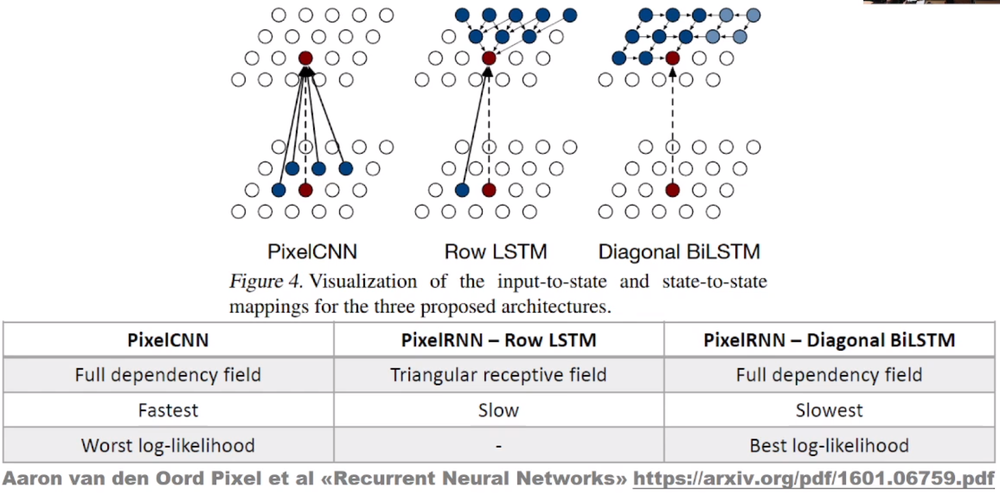

## PixelCNN: PixelCNN ++

Main idea: two stream (downward and downward + rightward) conv architechture with residual connection + downsampling and upsampling.

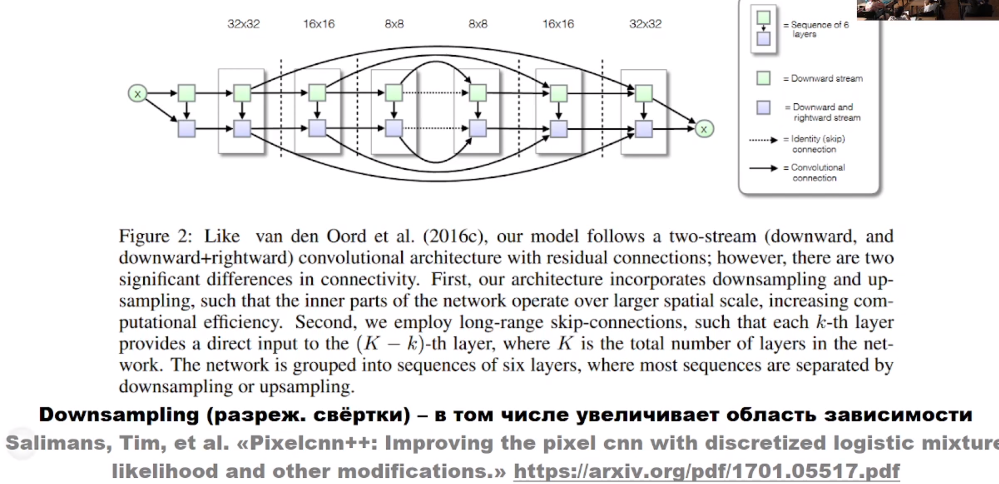

Refuse discrete distribution and softmax during generation. Use mixup of the simple distributions instead.

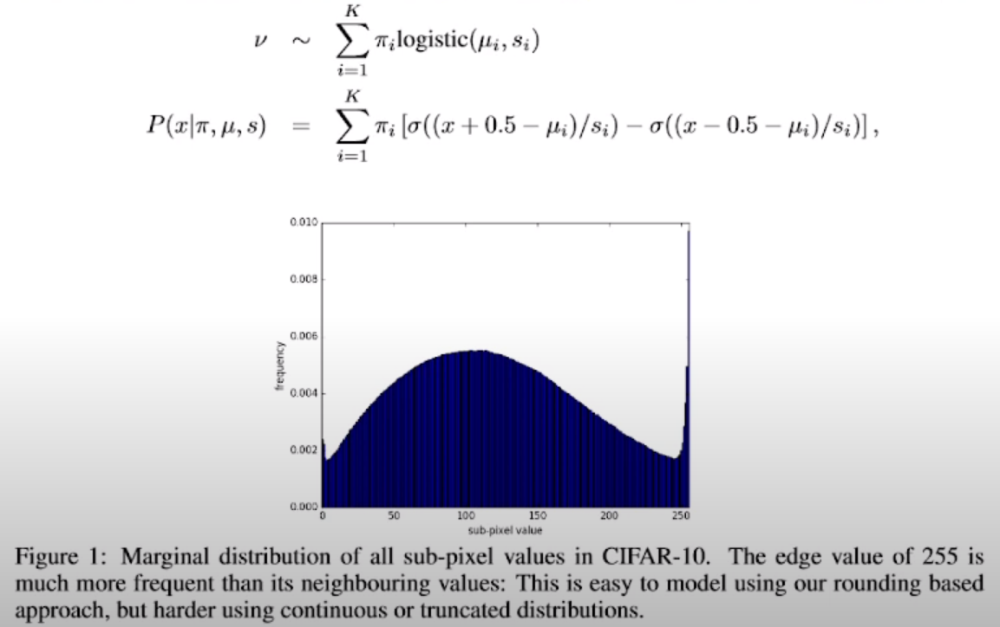

## Autoregressive models: PixelSnail

Main idea: CNN + attention

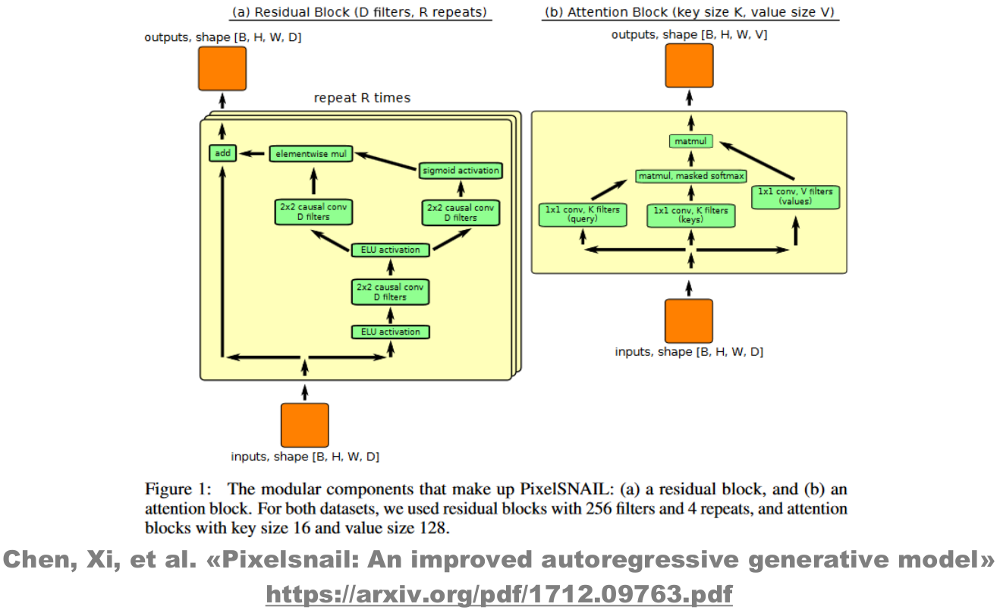

# Flow models

Main idea: we have some distribution with density (left) and cumulative distribution function (CDF) (right). 

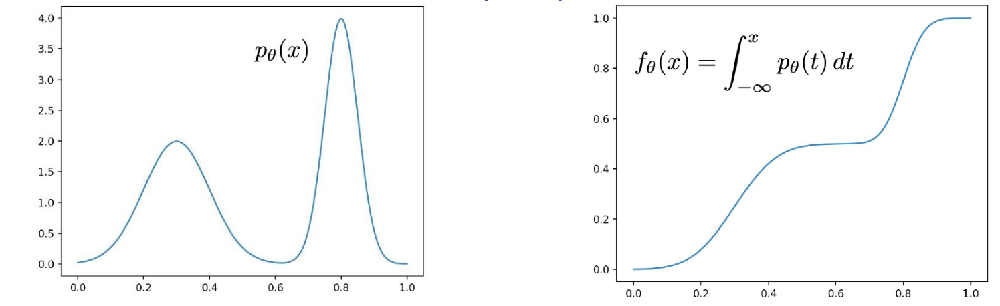

CDF maps the distribution onto the segment [0, 1]. So we can select point from [0, 1] and use CDF<sup>-1</sup> to obtain distribution value for this point.

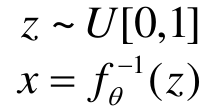

We can use any distribution we want (for example distribution of kitten images generated by NN) and generate desired values from this distribution.

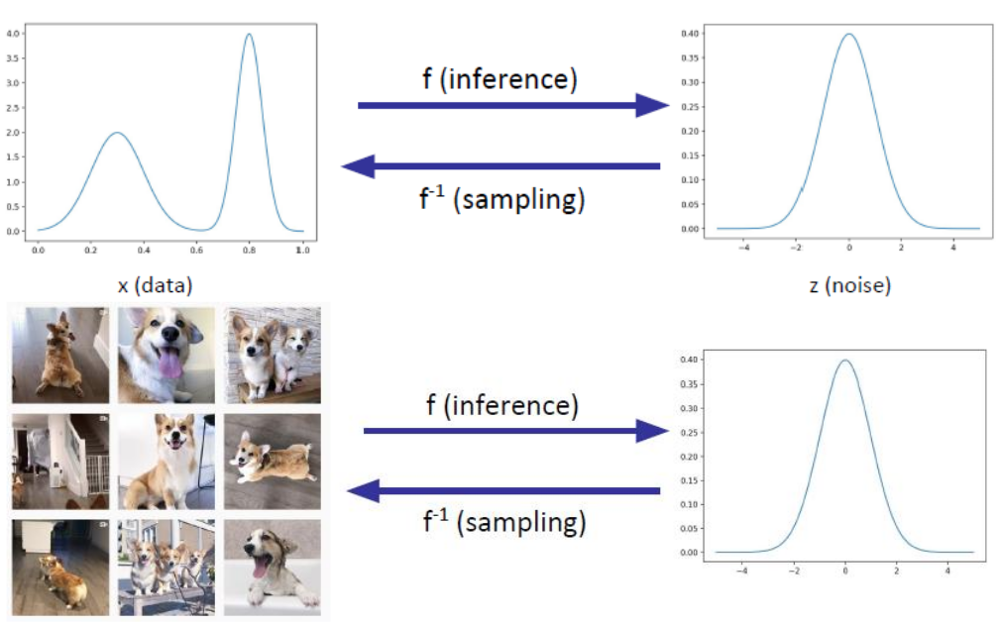

## Flow models: example

First row: before training - both distributions of x and z are bimodal

Second row: after training - distribution of z is uniform

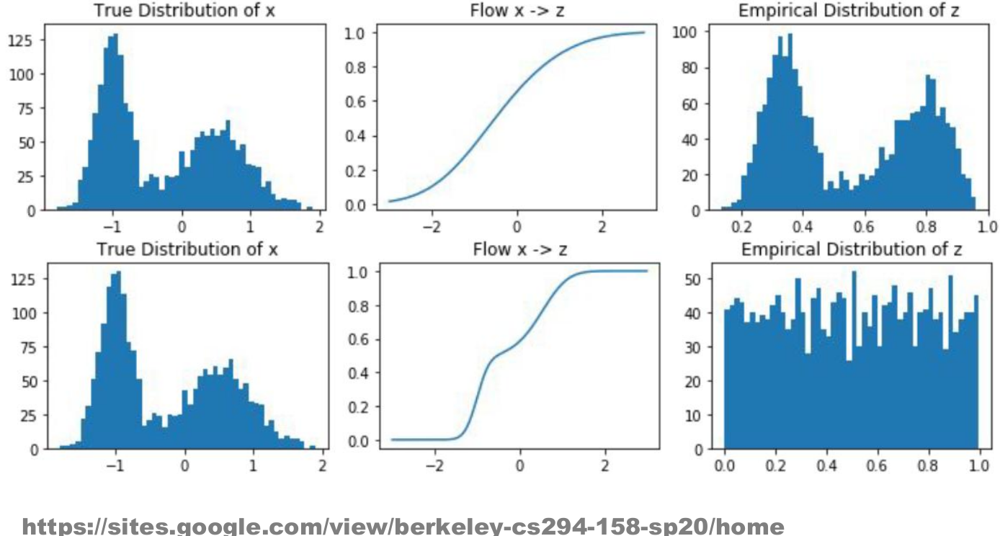

First row: after training - distribution of z is normal

Second row: after training - distribution of z is beta

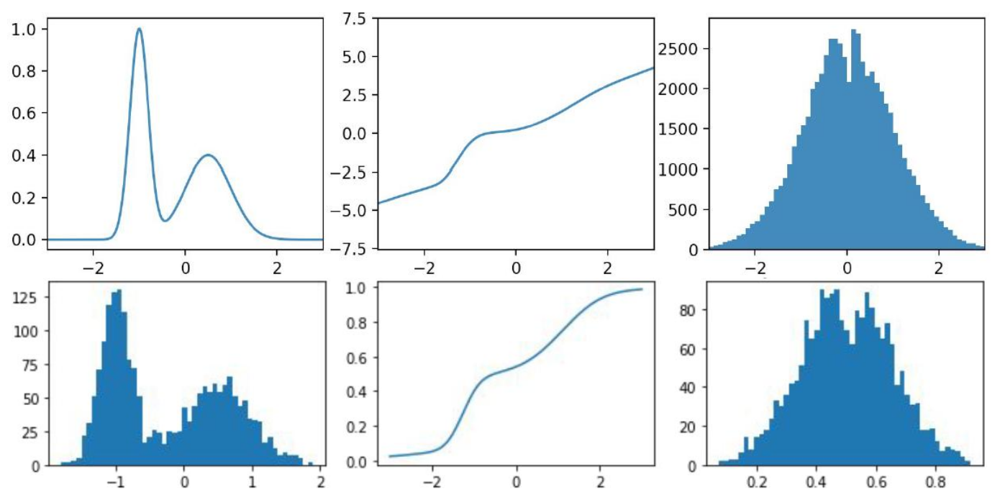

Another one example mapping between arbitrary distribution and a latent Gaussian distribution

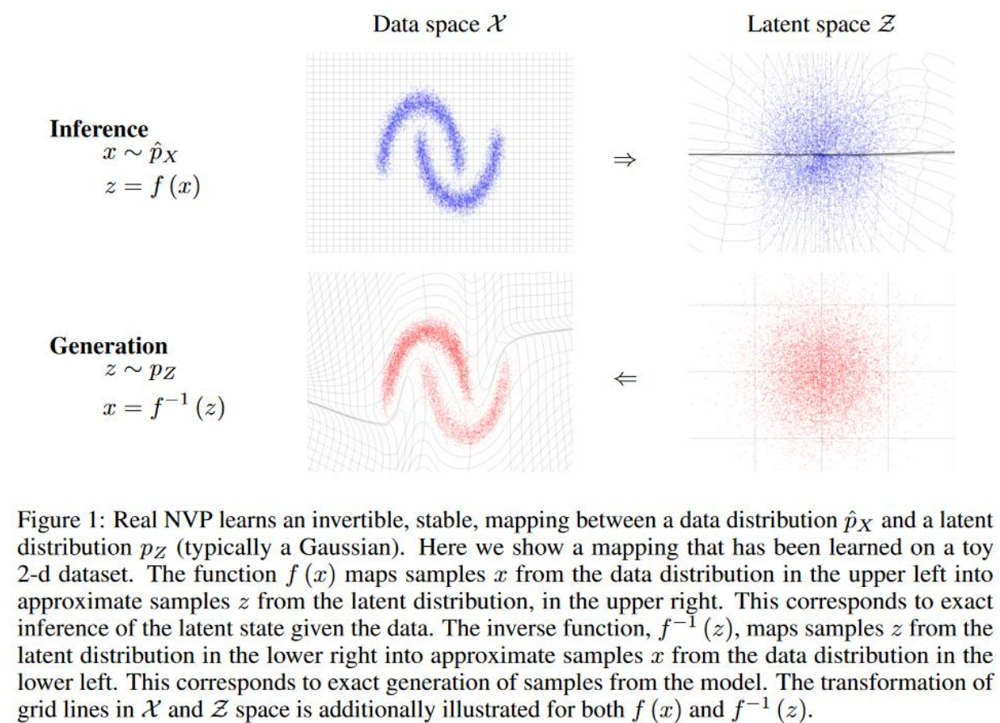

## Flow models: how it works?

Base is theorem about variable replacement:

Let x - some point, z - value of some function f<sub>θ</sub> in point x:

z = f<sub>θ</sub>(x), f<sub>θ</sub>: R<sup>n</sup> -> R<sup>n</sup> (f<sub>θ</sub> transforms from space with dimensiality n to space with the same dimensiality, this lets us to use square matrix for f<sub>θ</sub> transformation and determinant of this matrix is easy to calculate)

Then density value in point x:

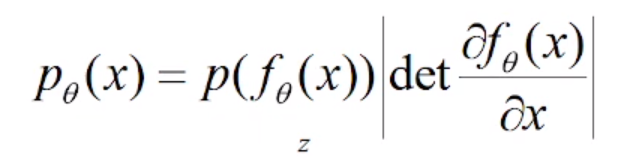

If we want to use Maximum Likelihood Estimate (MLE) method, we should rewrite this as:

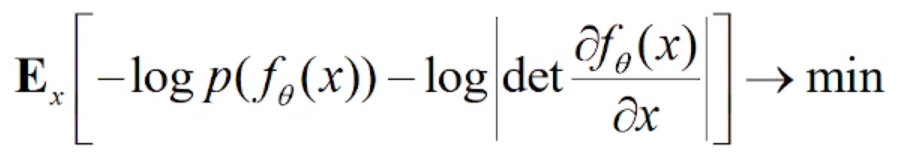

But one transformation f<sub>θ</sub>(x) may be not enough... Let's use chain of transformations (all of them must preserve dimensiality of original space).

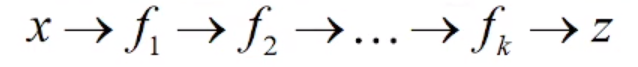

Then density value in point x:

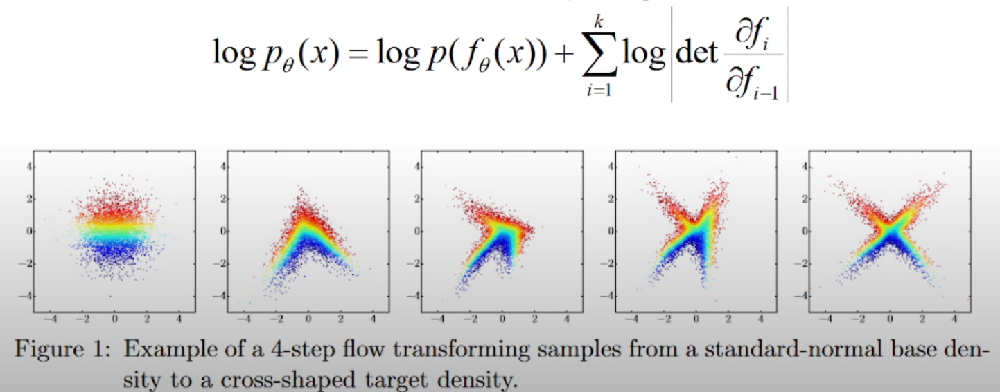

Main disadvantage of flows is that original space dimensiality must remain unchanged. That means that if input image data is 224 x 224 x 3, than output must have the same size.

## RealNVP (Non-volume preserving transformations)

Main idea: fast calculation of Jacobian determinant.

Split vector in two parts:

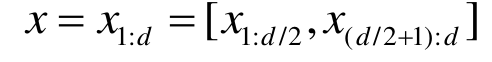

Let be:

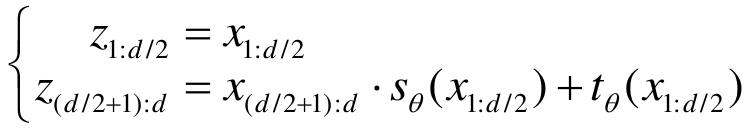, where s<sub>θ</sub> (!= 0) and t<sub>θ</sub> - arbitrary NNs.

Then Jacobian of z will we:

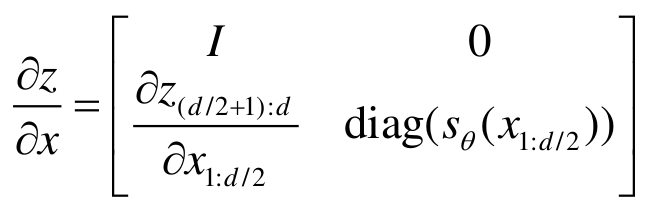

I in upper left corner and 0 in upper right corner because first part of z = first part of x. Bottom left and right corners can be derived from this fact too.

Determinant of this matrix will be:

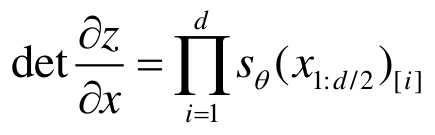

This determinant is very easy to calculate. So we can use it for fast forward/inverse transformations between distributions.

### RealNVP: Affine Coupling layers

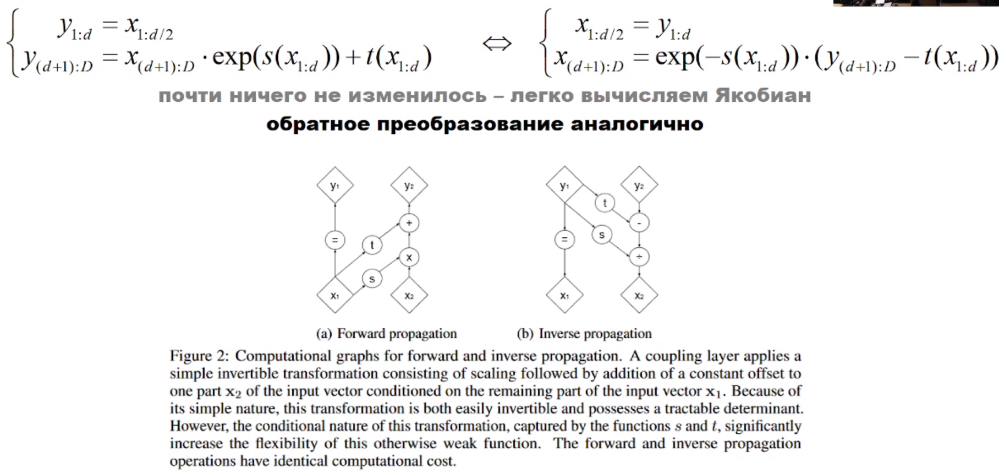

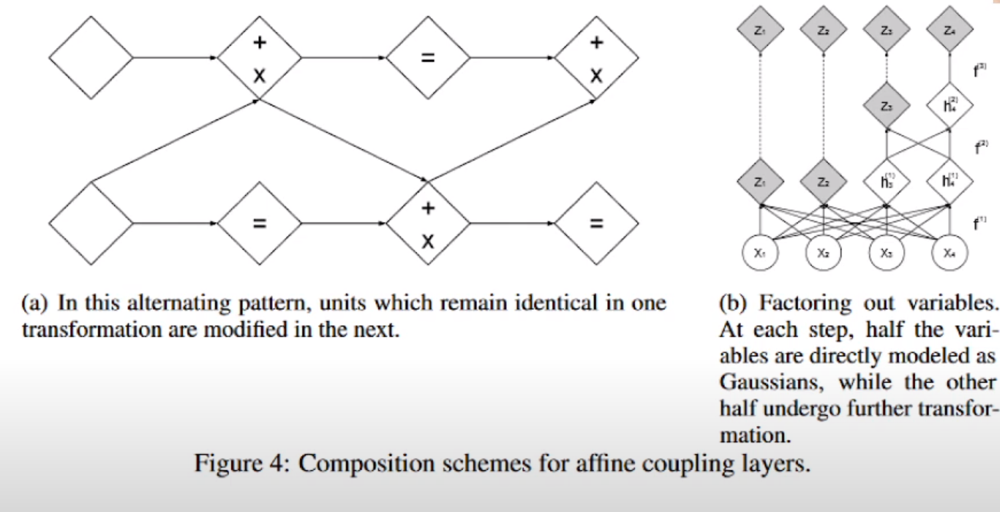

### RealNVP: Masked convolution

Vector splitting in two parts may be made with masks (in other case first part of variable of vector never changes and never takes part in Jacobian determinant calculation).

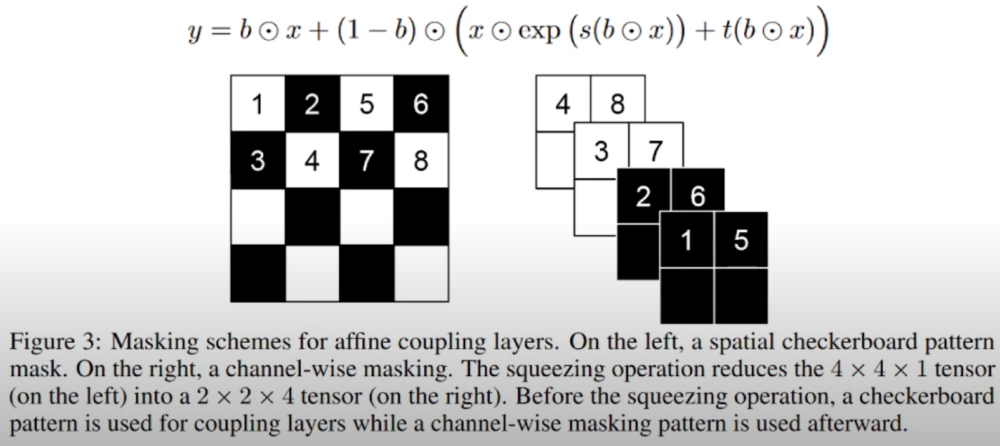

# Glow

Main idea: use invertible convolutions

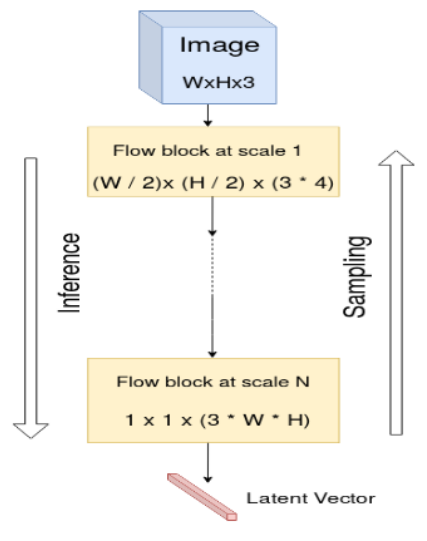

All transformations are invertible

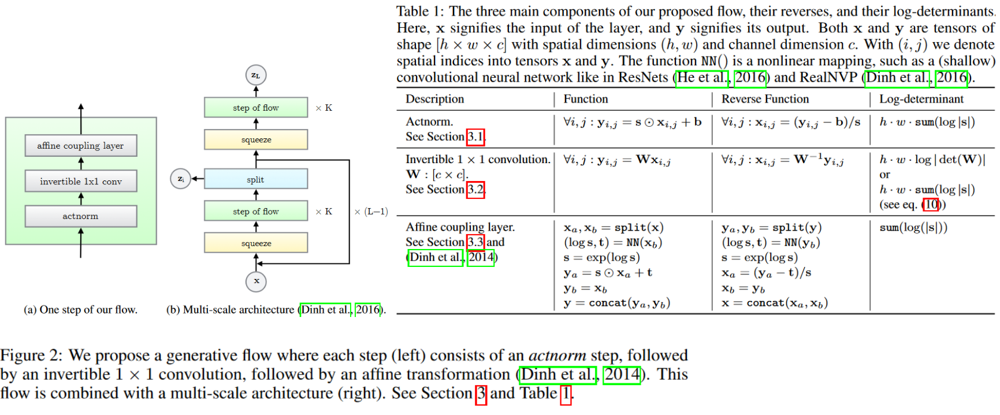

## Glow: Squeeze and Actnorm operations

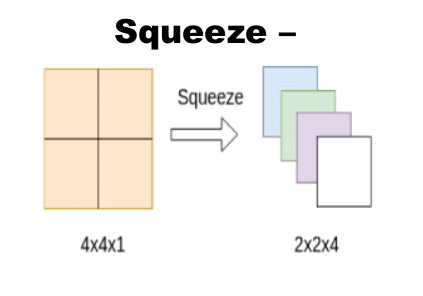

Actnorm is like batchnorm but because of big images batch size is 1 image => shift and normalization are made for each image channel separately and then train.

## Glow: Invertible convolutions

Main idea: invertible channel mixup

Channel - Channel transformation:

y<sub>i, j</sub> = W<sub>c x c</sub> x<sub>i, j</sub>

During backpropagation we need to canculate det(W<sub>c x c</sub>)

To decrease calculation complexity:

W = P * L * (U + diag(s)) (watch: PLU decomposition)

P - permutation matrix

L - low diagonal with 1s on diagonal

U - upper diagonal with 0s on diagonal

s - vector

In this case: log(det(W)) = sum(log(s))

I.e. we specially constructed matrix W like this to speed up calculation of it's determinant

More info here https://papers.nips.cc/paper/8224-glow-generative-flow-with-invertible-1x1-convolutions.pdf

# Autoregressive Flows

Main idea: mix of autoregression and Real NVP

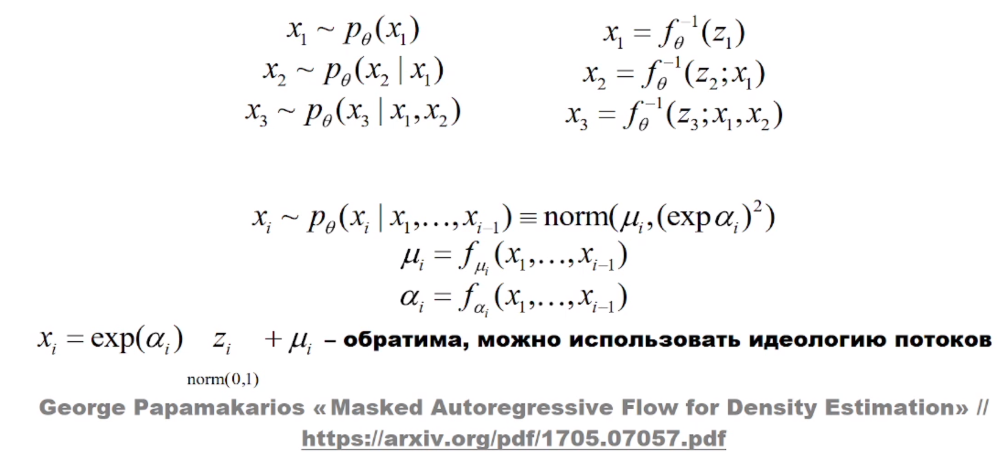

# DRAW - Deep Recurrent Attentive Writer

Main idea: RNN encoder + RNN decoder + attention. 

Do not generate image pixel-by-pixel but:
- use dynamically updated attention: constrain field of view of encoder and decoder response, this helps to pay attention to specific part of image during generation
- repeat process (make image more detailed)
- feedback: evaluate generation result by "looking" at full image
- encoder sees decoder states on previous step

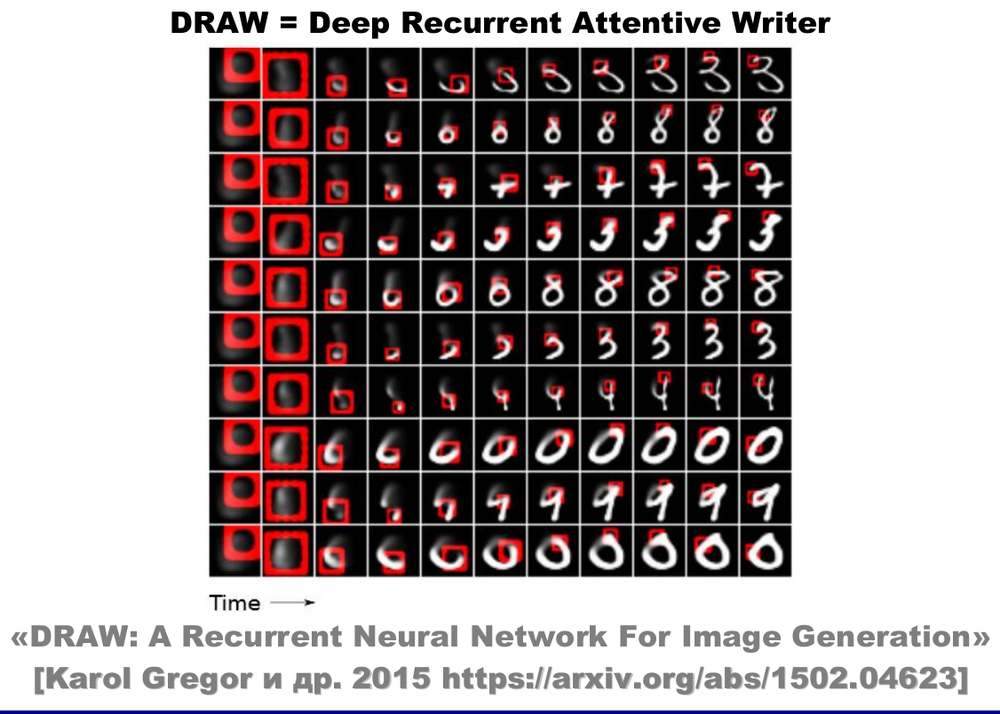